<a href="https://colab.research.google.com/github/mustafabozkaya/arge-odakli-yapay-zeka-egitimi2-sorulari/blob/main/movie_recommender_update.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [146]:
import os
for dirname, _, filenames in os.walk(''):
    for filename in filenames:
        print(os.path.join(dirname, filename))


In [147]:
!mkdir working
%cd working


/content/working/working/working/working/working


In [148]:
%pwd

'/content/working/working/working/working/working'

In [149]:
#!wget https://github.com/mustafabozkaya/arge-odakli-yapay-zeka-egitimi2-sorulari/tree/main/datasets/movies.csv datasets
!git clone https://github.com/mustafabozkaya/arge-odakli-yapay-zeka-egitimi2-sorulari.git 

Cloning into 'arge-odakli-yapay-zeka-egitimi2-sorulari'...
remote: Enumerating objects: 53, done.
remote: Counting objects: 100% (53/53), done.
remote: Compressing objects: 100% (49/49), done.
remote: Total 53 (delta 18), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (53/53), done.


In [150]:
#!wget https://github.com/mustafabozkaya/arge-odakli-yapay-zeka-egitimi2-sorulari/tree/main/datasets/ratings.csv

In [151]:
#!wget https://github.com/mustafabozkaya/arge-odakli-yapay-zeka-egitimi2-sorulari/tree/main/datasets/README.txt

# **Load Library**

In [152]:

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import plotly.express as px
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity
import re
from PIL import Image
import requests
import random
from sklearn.feature_extraction.text import CountVectorizer



In [153]:
!pip install -q nltk

In [154]:
import nltk # Natural Language Tool Kit 
from nltk.corpus import stopwords # Stopwords corpus is a list of commonly used words in a language

In [155]:
os.listdir("./arge-odakli-yapay-zeka-egitimi2-sorulari/datasets/")

['README.txt', 'movies.csv', 'ratings.csv']

In [156]:
!cat ./arge-odakli-yapay-zeka-egitimi2-sorulari/README.md

# Araştırma ve Geliştirme Odaklı Yapay Zeka Eğitimi Soruları


Başvuru kabulü için size sorulan soruyu çözmenizden çok, o soruyu çözmek için ne kadar uğraştığınız önemlidir. Motivasyonu yüksek gençlerle çalışmak çok farklı, bunu biliyoruz, sizi önemsiyoruz ve bekliyoruz.
 
## Soru - Film Önerme
MovieLens verisetini kullanarak kişilere film önerisi yapan bir fonksiyon geliştirmeniz beklenmektedir. Aşağıdaki notebook'u temel alarak çalışmanızı yapabilirsiniz. 

- [Film Önerme](https://github.com/kaveai/arge-odakli-yapay-zeka-egitimi2-sorulari/blob/main/Soru1.ipynb)


## Data Story

In [157]:
!cat ./arge-odakli-yapay-zeka-egitimi2-sorulari/datasets/README.txt

Summary

This dataset (ml-latest-small) describes 5-star rating and free-text tagging activity from [MovieLens](http://movielens.org), a movie recommendation service. It contains 100836 ratings and 3683 tag applications across 9742 movies. These data were created by 610 users between March 29, 1996 and September 24, 2018. This dataset was generated on September 26, 2018.

Users were selected at random for inclusion. All selected users had rated at least 20 movies. No demographic information is included. Each user is represented by an id, and no other information is provided.

The data are contained in the files `links.csv`, `movies.csv`, `ratings.csv` and `tags.csv`. More details about the contents and use of all these files follows.

This is a *development* dataset. As such, it may change over time and is not an appropriate dataset for shared research results. See available *benchmark* datasets if that is your intent.

This and other GroupLens data sets are publicly available for down

## Load & Check Datasets

In [158]:
dataset_dir="./arge-odakli-yapay-zeka-egitimi2-sorulari/datasets/"

In [159]:
movies = pd.read_csv(dataset_dir+'movies.csv')
movies.head()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [160]:
ratings = pd.read_csv(dataset_dir+'ratings.csv',parse_dates=["timestamp"])
ratings.head()

,userId,movieId,rating,timestamp
0,1,1,4.0,964982703
1,1,3,4.0,964981247
2,1,6,4.0,964982224
3,1,47,5.0,964983815
4,1,50,5.0,964982931


In [161]:
print("Movie Shape: " ,movies.shape )
print("Ratings Shape: " ,ratings.shape )

print("-"*30)

print("Any null values in Movie:" ,movies.isnull().values.any())
print("Any null values in Ratings: ",ratings.isnull().values.any())

print("-"*30)

print("How many null values in Which Movie's feature:\n" ,movies.isnull().sum())
print("-"*30)
print("How many null values in Which Ratings's feature:\n ",ratings.isnull().sum())


Movie Shape:  (9742, 3)
Ratings Shape:  (100836, 4)
------------------------------
Any null values in Movie: False
Any null values in Ratings:  False
------------------------------
How many null values in Which Movie's feature:
 movieId    0
title      0
genres     0
dtype: int64
------------------------------
How many null values in Which Ratings's feature:
  userId       0
movieId      0
rating       0
timestamp    0
dtype: int64


## Concanate Datasets

In [162]:
# MovieID üzerinden kişilerin yorumlarına film isimlerini ve genrelerini ekliyoruz. 
rating_movie = pd.merge(ratings, movies, how='left', on='movieId')

rating_movie.head()

,userId,movieId,rating,timestamp,title,genres
0,1,1,4.0,964982703,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,1,3,4.0,964981247,Grumpier Old Men (1995),Comedy|Romance
2,1,6,4.0,964982224,Heat (1995),Action|Crime|Thriller
3,1,47,5.0,964983815,Seven (a.k.a. Se7en) (1995),Mystery|Thriller
4,1,50,5.0,964982931,"Usual Suspects, The (1995)",Crime|Mystery|Thriller


**Yukarıdan da görebileceğiniz gibi, userId ve movieId, her kullanıcıyı ve filmi ayırt etmek için iki önemli sütundur. Derecelendirme olan aşağıdaki sütun için, bir veya daha fazla film için her kullanıcının derecelendirmesidir. Aşağıdaki sütun zaman damgası, UNIX tarih formatı açısından tarihi temsil eder. Ve son iki sütun, her filmin başlığını ve türünü temsil eder.**

In [163]:
# Number of Users who rated at least one movie:
print("Number of Users who rated at least one move: ", rating_movie.userId.nunique())
print("-"*30)

# Number of Movies in the dataset:
print("Number of Movies in the dataset:", rating_movie.movieId.nunique())
print("-"*30)

# Unique of Rating points in the dataset:
# Unique of Rating points in the dataset:
print("Unique Rating points:", rating_movie.rating.unique())

Number of Users who rated at least one move:  610
------------------------------
Number of Movies in the dataset: 9724
------------------------------
Unique Rating points: [4.  5.  3.  2.  1.  4.5 3.5 2.5 0.5 1.5]


In [164]:
# Extracting movie release years into one column
rating_movie['movie_year'] = rating_movie.title.str.extract('.*\((.*)\).*') # extract() method is used to extract the string from the given string  .*\((.*)\).* means the string which is not a word or digit and (.*) means the string which is not a word or digit and (\) means the string which is not a word or digit
rating_movie.head()

,userId,movieId,rating,timestamp,title,genres,movie_year
0,1,1,4.0,964982703,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995
1,1,3,4.0,964981247,Grumpier Old Men (1995),Comedy|Romance,1995
2,1,6,4.0,964982224,Heat (1995),Action|Crime|Thriller,1995
3,1,47,5.0,964983815,Seven (a.k.a. Se7en) (1995),Mystery|Thriller,1995
4,1,50,5.0,964982931,"Usual Suspects, The (1995)",Crime|Mystery|Thriller,1995


In [165]:
# Removing year from the movie title
rating_movie['title'] = rating_movie.title.str.replace('(\(\d\d\d\d\))', '') # replace() method is used to replace the string with another string

rating_movie.head()

,userId,movieId,rating,timestamp,title,genres,movie_year
0,1,1,4.0,964982703,Toy Story,Adventure|Animation|Children|Comedy|Fantasy,1995
1,1,3,4.0,964981247,Grumpier Old Men,Comedy|Romance,1995
2,1,6,4.0,964982224,Heat,Action|Crime|Thriller,1995
3,1,47,5.0,964983815,Seven (a.k.a. Se7en),Mystery|Thriller,1995
4,1,50,5.0,964982931,"Usual Suspects, The",Crime|Mystery|Thriller,1995


In [166]:
# convert timestamp to datetime
rating_movie['timestamp'] = pd.to_datetime(rating_movie['timestamp'], unit='s')
rating_movie.head()

,userId,movieId,rating,timestamp,title,genres,movie_year
0,1,1,4.0,2000-07-30 18:45:03,Toy Story,Adventure|Animation|Children|Comedy|Fantasy,1995
1,1,3,4.0,2000-07-30 18:20:47,Grumpier Old Men,Comedy|Romance,1995
2,1,6,4.0,2000-07-30 18:37:04,Heat,Action|Crime|Thriller,1995
3,1,47,5.0,2000-07-30 19:03:35,Seven (a.k.a. Se7en),Mystery|Thriller,1995
4,1,50,5.0,2000-07-30 18:48:51,"Usual Suspects, The",Crime|Mystery|Thriller,1995


In [167]:
# s,plitting genres into list of genres
rating_movie['genres'] = rating_movie.genres.str.split('|')
rating_movie.head()

,userId,movieId,rating,timestamp,title,genres,movie_year
0,1,1,4.0,2000-07-30 18:45:03,Toy Story,"[Adventure, Animation, Children, Comedy, Fantasy]",1995
1,1,3,4.0,2000-07-30 18:20:47,Grumpier Old Men,"[Comedy, Romance]",1995
2,1,6,4.0,2000-07-30 18:37:04,Heat,"[Action, Crime, Thriller]",1995
3,1,47,5.0,2000-07-30 19:03:35,Seven (a.k.a. Se7en),"[Mystery, Thriller]",1995
4,1,50,5.0,2000-07-30 18:48:51,"Usual Suspects, The","[Crime, Mystery, Thriller]",1995


In [168]:
# fro faster processing of large size data 
# we save it as a parquet file or pickle file
# but parquet  takes up less space 
rating_movie.to_parquet("ratesmovies.parquet",compression="gzip") 
rating_movie.to_pickle("ratesmovies.pickle")

In [169]:
data=pd.read_parquet("ratesmovies.parquet")

**Yukarıda keşfettiğimiz gibi, tam sayı olmayan bazı derecelendirmeler vardır. Benzersiz derecelendirme noktalarının sayısını daraltmak için tavan işlevini kullanacağım ve yalnızca 1 ile 5 arasında derecelendirmeler elde edeceğim.**

In [170]:
# Removing decimal values to the ceiling value to decrease number of rating classes
data.rating = np.ceil(data.rating)
print("Unique Rating Points:", data.rating.unique())

Unique Rating Points: [4. 5. 3. 2. 1.]


## Exploratary Data analysis

In [171]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100836 entries, 0 to 100835
Data columns (total 7 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   userId      100836 non-null  int64         
 1   movieId     100836 non-null  int64         
 2   rating      100836 non-null  float64       
 3   timestamp   100836 non-null  datetime64[ns]
 4   title       100836 non-null  object        
 5   genres      100836 non-null  object        
 6   movie_year  100819 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(2), object(3)
memory usage: 6.2+ MB


In [172]:
data.describe()

,userId,movieId,rating
count,100836.000000,100836.000000,100836.000000
mean,326.127564,19435.295718,3.652287
std,182.618491,35530.987199,1.045238
min,1.000000,1.000000,1.000000
25%,177.000000,1199.000000,3.000000
50%,325.000000,2991.000000,4.000000
75%,477.000000,8122.000000,4.000000
max,610.000000,193609.000000,5.000000


In [173]:
# display the number of ratings for each user
data.groupby('userId')['rating'].count().sort_values(ascending=False).head(10)

userId
414    2698
599    2478
474    2108
448    1864
274    1346
610    1302
68     1260
380    1218
606    1115
288    1055
Name: rating, dtype: int64

In [174]:
#plotting the number of ratings for each user
#data.groupby('userId')['rating'].count().sort_values(ascending=False).hist(bins=50)



In [175]:
#display the number of ratings for each movie and sort them by movieId
data.groupby('movieId')['rating'].count().sort_values(ascending=False).head(10)


movieId
356     329
318     317
296     307
593     279
2571    278
260     251
480     238
110     237
589     224
527     220
Name: rating, dtype: int64

In [176]:
def EDA(data):
    fig = px.histogram(data, x="userId", color="rating", marginal="box", hover_data=data.columns)
    fig.update_layout(title_text='Number of ratings for each user')
    fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                    marker_line_width=1.5, opacity=0.6)
    fig.show()
    
    fig=px.histogram(data, x="movieId", color="rating", marginal="box", hover_data=data.columns)
    fig.update_layout(title_text='Number of ratings for each movie')
    fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)', 
                    marker_line_width=1.5, opacity=0.6)
    fig.show()

EDA(data)

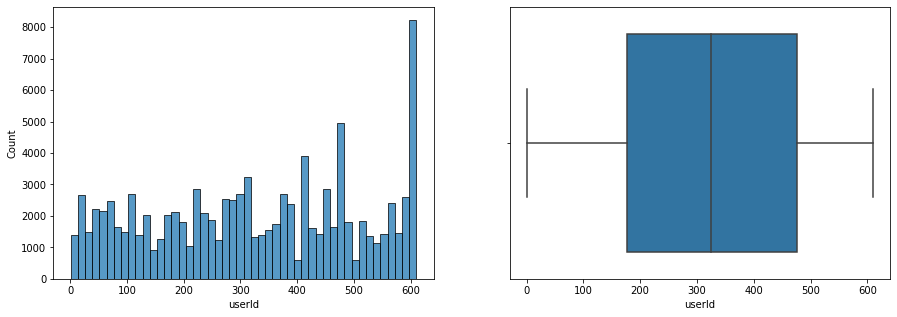

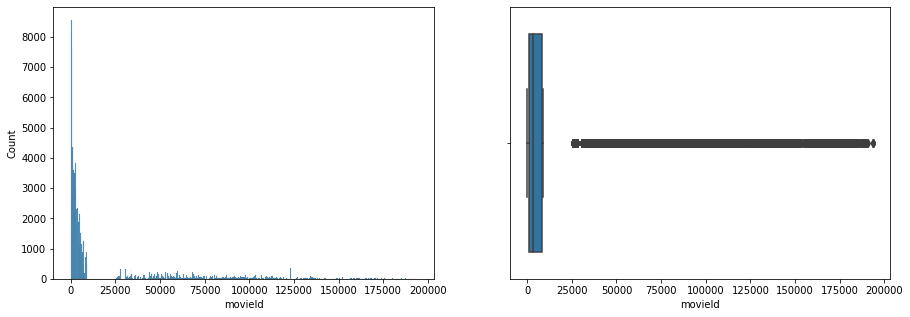

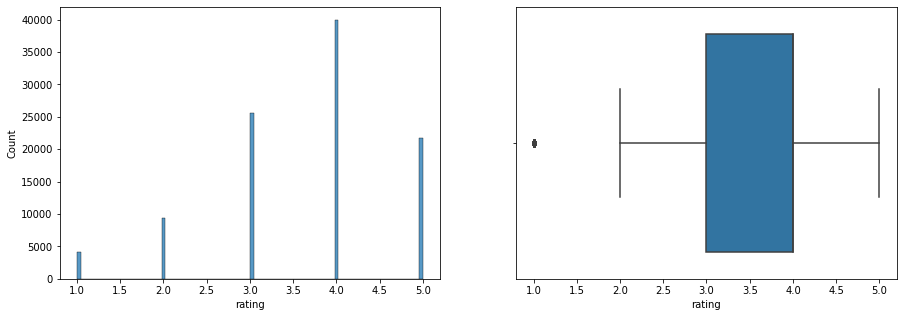

In [177]:
def plot_hist_box2(data, features):
    for feature in features:
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))
        sns.histplot(data=data, x=feature, ax=axes[0])
        sns.boxplot(data=data, x=feature, ax=axes[1])
        plt.show()

 
def plot_hist_box(data, features):
    for feature in features:
        fig = px.histogram(data, x=feature, marginal="box", hover_data=data.columns,labels={x:feature,y:"Frequency"})
        fig.update_layout(title_text='Distribution of {}'.format(feature))
        fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                        marker_line_width=1.5, opacity=0.6)
        fig.show()


def plotHistogram(degisken):
    plt.figure(figsize=(12,8))
    plt.hist(rating_movie[degisken],bins=40,color="green",density=False)
    plt.xlabel(degisken)
    plt.ylabel("Frekans")
    plt.title("Veri Sıklığı - {}".format(degisken))
    plt.show()


def plotbox(numericvar):
    # setting the dimensions of the plot
    fig, ax = plt.subplots(figsize=(20, 5))
    sns.boxplot(x=rating_movie[numericvar])
    plt.title(f"{numericvar} Değişkeni İçin Kutu Grafiği(only Numeric(nicel-quantitative data))")
    plt.xlabel(numericvar)
    plt.ylabel("Değerler")
    plt.show()
# for var in rating_movie.select_dtypes(exclude=["object","category","datetime"]).columns:
#     plotbox(var)

numeric_variables=data.select_dtypes([np.number]).columns

plot_hist_box2(data,numeric_variables)

## Preprocessing

In [178]:
data.head(10)

,userId,movieId,rating,timestamp,title,genres,movie_year
0,1,1,4.0,2000-07-30 18:45:03,Toy Story,"[Adventure, Animation, Children, Comedy, Fantasy]",1995
1,1,3,4.0,2000-07-30 18:20:47,Grumpier Old Men,"[Comedy, Romance]",1995
2,1,6,4.0,2000-07-30 18:37:04,Heat,"[Action, Crime, Thriller]",1995
3,1,47,5.0,2000-07-30 19:03:35,Seven (a.k.a. Se7en),"[Mystery, Thriller]",1995
4,1,50,5.0,2000-07-30 18:48:51,"Usual Suspects, The","[Crime, Mystery, Thriller]",1995
5,1,70,3.0,2000-07-30 18:40:00,From Dusk Till Dawn,"[Action, Comedy, Horror, Thriller]",1996
6,1,101,5.0,2000-07-30 18:14:28,Bottle Rocket,"[Adventure, Comedy, Crime, Romance]",1996
7,1,110,4.0,2000-07-30 18:36:16,Braveheart,"[Action, Drama, War]",1995
8,1,151,5.0,2000-07-30 19:07:21,Rob Roy,"[Action, Drama, Romance, War]",1995
9,1,157,5.0,2000-07-30 19:08:20,Canadian Bacon,"[Comedy, War]",1995


In [179]:
def preprocess(df):

    data=df.copy()
    data.dropna(inplace=True)
    
    #create filter for movies with more than 10 ratings
    filter = data['movieId'].value_counts() > 10
    filter = filter[filter].index.tolist()  # return the index of the filter
    data = data[(data['movieId'].isin(filter))]

    # create filter for users with more than 1 ratings
    filter = data['userId'].value_counts() > 1
    filter = filter[filter].index.tolist()
    data = data[(data['userId'].isin(filter))]
    data.shape

    # drop duplicates titles
    # drop_duplicates() method is used to remove duplicate values from the dataframe
    data.drop_duplicates(subset=['title'], keep='first', inplace=True)

    
    data.drop(index=data[data["rating"]==0].index,inplace=True) # drop rows with rating 0
    data["title"]=data["title"].apply(lambda x: re.sub("[\W_]+"," ",x).strip()) # remove non-alphanumeric characters
  
    return data
  
data=preprocess(data)
data.head()



,userId,movieId,rating,timestamp,title,genres,movie_year
0,1,1,4.0,2000-07-30 18:45:03,Toy Story,"[Adventure, Animation, Children, Comedy, Fantasy]",1995
1,1,3,4.0,2000-07-30 18:20:47,Grumpier Old Men,"[Comedy, Romance]",1995
2,1,6,4.0,2000-07-30 18:37:04,Heat,"[Action, Crime, Thriller]",1995
3,1,47,5.0,2000-07-30 19:03:35,Seven a k a Se7en,"[Mystery, Thriller]",1995
4,1,50,5.0,2000-07-30 18:48:51,Usual Suspects The,"[Crime, Mystery, Thriller]",1995


In [180]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2101 entries, 0 to 44843
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   userId      2101 non-null   int64         
 1   movieId     2101 non-null   int64         
 2   rating      2101 non-null   float64       
 3   timestamp   2101 non-null   datetime64[ns]
 4   title       2101 non-null   object        
 5   genres      2101 non-null   object        
 6   movie_year  2101 non-null   object        
dtypes: datetime64[ns](1), float64(1), int64(2), object(3)
memory usage: 195.9+ KB


In [190]:
# Created a (movieId: title) dictionary for all movieId's for replacing them with their names
movie_dict = dict(zip(data.movieId, data.title))
list(movie_dict.items())[:5]

[(1, 'Toy Story'),
 (3, 'Grumpier Old Men'),
 (6, 'Heat'),
 (47, 'Seven a k a Se7en'),
 (50, 'Usual Suspects The')]

In [209]:
# a movie recommender system using the pivot table
recommendData = data.pivot_table(
    index='userId', columns='movieId', values='rating').fillna(0)



In [210]:
#replace pivot movieId with data title
recommendData.columns = recommendData.columns.map(movie_dict)
recommendData


movieId,Toy Story,Jumanji,Grumpier Old Men,Father of the Bride Part II,Heat,Sabrina,Sudden Death,GoldenEye,American President The,Dracula Dead and Loving It,...,Now You See Me 2,Arrival,Rogue One A Star Wars Story,Get Out,Logan,Dunkirk,Blade Runner 2049,Coco,Star Wars The Last Jedi,Deadpool 2
userId,,,,,,,,,,,,,,,,,,,,,
1,4.0,0.0,4.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
226,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
232,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
249,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [217]:

def recommend_movie(movie_title:str):
    # get the index of the movie that matches the title
    idx = recommendData.columns.get_loc(movie_title.capitalize())
    # get the genres of the movie that matches the title
    # get the pairwise similarity scores of all movies with that movie
    sim_scores = list(enumerate(cosine_similarity(recommendData, recommendData)[idx]))
    # sort the movies based on the similarity scores
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)
    # get the scores of the 10 most similar movies
    sim_scores = sim_scores[1:11]
    # get the movie indices
    movie_indices = [i[0] for i in sim_scores]
    # return the top 10 most similar movies

    print("Top 10 movies similar to Jumanji are:")

    #convert the result to a list
    result = recommendData.columns[movie_indices].tolist()
    return result

def recommend_movie2(movie_title:str):
  
    # get the genres of the movie that matches the title
    genres = data[data['title'] == movie_title.capitalize()]['genres'].values[0]
    
    # get other movies with the same genres
    movies = data[data['genres'] == genres]['title'].values
    # get the index of the movies that matches the genres
    idxs = [recommendData.columns.get_loc(movie) for movie in movies]

    # get the average rating of the movies that matches the genres
    avg_ratings = recommendData.iloc[:, idxs].mean().values

    # get the index of the movies that matches the genres and sort them by rating
    idxs = np.argsort(avg_ratings)[::-1]

    # get the top 10 movies that matches the genres and sort them by rating

    top_10 = [movies[idx] for idx in idxs[:10]]

    print("Top 10 movies similar to Jumanji are:")


    #convert the result to a list
    result = top_10.tolist()

    return result





In [218]:
recommend_movie("Jumanji")

Top 10 movies similar to Jumanji are:


['Toy Story',
 'Grumpier Old Men',
 'Father of the Bride Part II',
 'Heat',
 'Sabrina',
 'Sudden Death',
 'GoldenEye',
 'American President The',
 'Dracula Dead and Loving It',
 'Nixon']

In [ ]:
%pip install streamlit

In [ ]:
import streamlit as st

st.title("Movie Recommender System")

movie_name = st.text_input("Enter a movie name (e.g. Jumanji)")

if st.button("Recommend"):
    result=recommend_movie(movie_name)

    #displat result list on screen
    st.write(result)